# Part 1 - Prosper Loan Exploration

### Aghazada Samir

## Introduction

In this project I want to explore who has the best profile to get loan. In order to find this kind of profile, I have analysed the given data from different aspects. 



## Preliminary Wrangling

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sb
import plotly.express as px
import plotly.graph_objects as go

%matplotlib inline

In [2]:
df=pd.read_csv('prosperLoanData.csv',encoding='latin-1', low_memory=False)
df.head()

,ListingKey,ListingNumber,ListingCreationDate,CreditGrade,Term,LoanStatus,ClosedDate,BorrowerAPR,BorrowerRate,LenderYield,...,LP_ServiceFees,LP_CollectionFees,LP_GrossPrincipalLoss,LP_NetPrincipalLoss,LP_NonPrincipalRecoverypayments,PercentFunded,Recommendations,InvestmentFromFriendsCount,InvestmentFromFriendsAmount,Investors
0,1021339766868145413AB3B,193129,2007-08-26 19:09:29.263000000,C,36,Completed,2009-08-14 00:00:00,0.16516,0.1580,0.1380,...,-133.18,0.0,0.0,0.0,0.0,1.0,0,0,0.0,258
1,10273602499503308B223C1,1209647,2014-02-27 08:28:07.900000000,NaN,36,Current,NaN,0.12016,0.0920,0.0820,...,0.00,0.0,0.0,0.0,0.0,1.0,0,0,0.0,1
2,0EE9337825851032864889A,81716,2007-01-05 15:00:47.090000000,HR,36,Completed,2009-12-17 00:00:00,0.28269,0.2750,0.2400,...,-24.20,0.0,0.0,0.0,0.0,1.0,0,0,0.0,41
3,0EF5356002482715299901A,658116,2012-10-22 11:02:35.010000000,NaN,36,Current,NaN,0.12528,0.0974,0.0874,...,-108.01,0.0,0.0,0.0,0.0,1.0,0,0,0.0,158
4,0F023589499656230C5E3E2,909464,2013-09-14 18:38:39.097000000,NaN,36,Current,NaN,0.24614,0.2085,0.1985,...,-60.27,0.0,0.0,0.0,0.0,1.0,0,0,0.0,20


In [3]:
df.shape

(113937, 81)

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 113937 entries, 0 to 113936
Data columns (total 81 columns):
 #   Column                               Non-Null Count   Dtype  
---  ------                               --------------   -----  
 0   ListingKey                           113937 non-null  object 
 1   ListingNumber                        113937 non-null  int64  
 2   ListingCreationDate                  113937 non-null  object 
 3   CreditGrade                          28953 non-null   object 
 4   Term                                 113937 non-null  int64  
 5   LoanStatus                           113937 non-null  object 
 6   ClosedDate                           55089 non-null   object 
 7   BorrowerAPR                          113912 non-null  float64
 8   BorrowerRate                         113937 non-null  float64
 9   LenderYield                          113937 non-null  float64
 10  EstimatedEffectiveYield              84853 non-null   float64
 11  EstimatedLoss

In [84]:
df['ProsperRating (Alpha)'].value_counts()

C     18345
B     15581
A     14551
D     14274
E      9795
HR     6935
AA     5372
Name: ProsperRating (Alpha), dtype: int64

In [5]:
df['ListingCreationDate']=pd.to_datetime(df['ListingCreationDate']).dt.year
df['ClosedDate']=pd.to_datetime(df['ClosedDate'])
df['LoanOriginationDate']=pd.to_datetime(df['LoanOriginationDate'])
df['DateCreditPulled']=pd.to_datetime(df['DateCreditPulled'])

In [6]:
df['IncomeRange'].unique()

array(['$25,000-49,999', '$50,000-74,999', 'Not displayed', '$100,000+',
       '$75,000-99,999', '$1-24,999', 'Not employed', '$0'], dtype=object)

In [7]:
df[df.duplicated()]

,ListingKey,ListingNumber,ListingCreationDate,CreditGrade,Term,LoanStatus,ClosedDate,BorrowerAPR,BorrowerRate,LenderYield,...,LP_ServiceFees,LP_CollectionFees,LP_GrossPrincipalLoss,LP_NetPrincipalLoss,LP_NonPrincipalRecoverypayments,PercentFunded,Recommendations,InvestmentFromFriendsCount,InvestmentFromFriendsAmount,Investors


In [8]:
df.describe()

,ListingNumber,ListingCreationDate,Term,BorrowerAPR,BorrowerRate,LenderYield,EstimatedEffectiveYield,EstimatedLoss,EstimatedReturn,ProsperRating (numeric),...,LP_ServiceFees,LP_CollectionFees,LP_GrossPrincipalLoss,LP_NetPrincipalLoss,LP_NonPrincipalRecoverypayments,PercentFunded,Recommendations,InvestmentFromFriendsCount,InvestmentFromFriendsAmount,Investors
count,1.139370e+05,113937.000000,113937.000000,113912.000000,113937.000000,113937.000000,84853.000000,84853.000000,84853.000000,84853.000000,...,113937.000000,113937.000000,113937.000000,113937.000000,113937.000000,113937.000000,113937.000000,113937.000000,113937.000000,113937.000000
mean,6.278857e+05,2011.012481,40.830248,0.218828,0.192764,0.182701,0.168661,0.080306,0.096068,4.072243,...,-54.725641,-14.242698,700.446342,681.420499,25.142686,0.998584,0.048027,0.023460,16.550751,80.475228
std,3.280762e+05,2.504353,10.436212,0.080364,0.074818,0.074516,0.068467,0.046764,0.030403,1.673227,...,60.675425,109.232758,2388.513831,2357.167068,275.657937,0.017919,0.332353,0.232412,294.545422,103.239020
min,4.000000e+00,2005.000000,12.000000,0.006530,0.000000,-0.010000,-0.182700,0.004900,-0.182700,1.000000,...,-664.870000,-9274.750000,-94.200000,-954.550000,0.000000,0.700000,0.000000,0.000000,0.000000,1.000000
25%,4.009190e+05,2008.000000,36.000000,0.156290,0.134000,0.124200,0.115670,0.042400,0.074080,3.000000,...,-73.180000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,2.000000
50%,6.005540e+05,2012.000000,36.000000,0.209760,0.184000,0.173000,0.161500,0.072400,0.091700,4.000000,...,-34.440000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,44.000000
75%,8.926340e+05,2013.000000,36.000000,0.283810,0.250000,0.240000,0.224300,0.112000,0.116600,5.000000,...,-13.920000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,115.000000
max,1.255725e+06,2014.000000,60.000000,0.512290,0.497500,0.492500,0.319900,0.366000,0.283700,7.000000,...,32.060000,0.000000,25000.000000,25000.000000,21117.900000,1.012500,39.000000,33.000000,25000.000000,1189.000000


<AxesSubplot:>

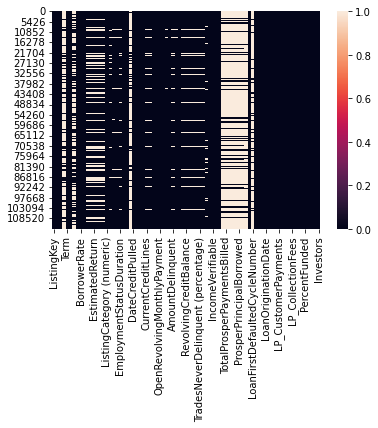

In [9]:
sb.heatmap(df.isna())

In [10]:
df['Occupation'].value_counts()

Other                          28617
Professional                   13628
Computer Programmer             4478
Executive                       4311
Teacher                         3759
                               ...  
Dentist                           68
Student - College Freshman        41
Student - Community College       28
Judge                             22
Student - Technical School        16
Name: Occupation, Length: 67, dtype: int64

## Structure of Dataset

The Dataset has 113937 rows and 81 columns. There were different data types in the dataset as float, integer and bool. After some wrangling process I converted the columns with date to datetime type.

## Main features of interest in the Dataset

The main interest is to find the most reliable people to lend money. One other interest may be analyse actual return and estimated return.

## Which features can help me to investigate my interest in the Dataset?

The Dataset is wide and almost gives detailed information about every single given loan. To find what we actually want I will use specific columns. I guess date columns will give me clear overlook to identify if proper load are paid back on time. I want to divide the data of people into parts, for that occupation, Employment status, customers income columns can be helpful to me.

## Univariante Exploration
let's start to look which occupations people have.

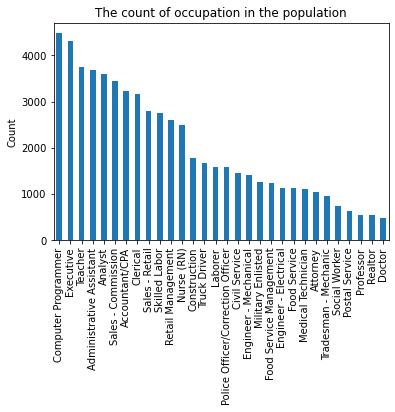

In [11]:
"""
The bar chart demonstrates counts of occupations that people have in the dataset. Here I droped first 2 column which were 
other and professionals. These columns do not clearly convey information. We can see top 3 occupations are Computer programmer,
Executive and Teachers. 
"""

df['Occupation'].value_counts()[2:32].plot(kind='bar')
plt.ylabel("Count")
plt.title("The count of occupation in the population");

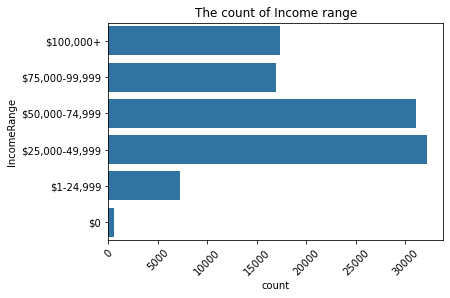

In [12]:
"""
The vertical bar chart represents income range of borrowers. It is clear that most of the people's income
changes from $25,000 to $75,000.
"""

base_color = sb.color_palette()[0]
sb.countplot(data=df, y='IncomeRange',color=base_color, order=['$100,000+','$75,000-99,999', '$50,000-74,999','$25,000-49,999','$1-24,999','$0'])
plt.xticks(rotation=45)
plt.title("The count of Income range");

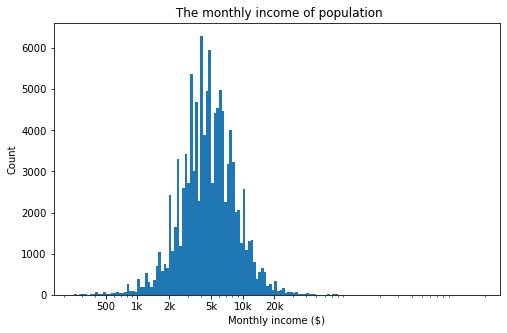

In [13]:
"""
The histogram shows stated monthly income of people who want to borrow money. It shows us most of the people
have 5k dollars in a month in general.

"""

log_binsize = 0.025
bins = 10 ** np.arange(2.4, np.log10(df['StatedMonthlyIncome'].max())+log_binsize, log_binsize)
plt.figure(figsize=[8, 5])
plt.hist(data = df, x = 'StatedMonthlyIncome', bins = bins)
plt.xscale('log')
plt.xticks([500, 1e3, 2e3, 5e3, 1e4, 2e4], [500, '1k', '2k', '5k', '10k', '20k'])
plt.xlabel('Monthly income ($)')
plt.ylabel("Count")
plt.title(" The monthly income of population")
plt.show()

In [14]:
df['StatedMonthlyIncome'].describe()

count    1.139370e+05
mean     5.608026e+03
std      7.478497e+03
min      0.000000e+00
25%      3.200333e+03
50%      4.666667e+03
75%      6.825000e+03
max      1.750003e+06
Name: StatedMonthlyIncome, dtype: float64

In [15]:
"""
The percentages and number of borrowers are shown in the pie chart. Only 7.9 percentage of people are not employed.
You can find the number of every slice if you move the mouse on the chart.
"""

names=['Employed','Full Time','Self Employed','Other','Part-Time','Not Employed','Retired']
fig = px.pie(df, values=df['EmploymentStatus'].value_counts().drop('Not available'), names=names, title='The labour percentages of borrowers')
fig.show()

In [118]:
"""
The line chart represents the amount of pulled Credits by years from 2006 to 2014. The chart clearly shows that 
pulled credit increased year by year. 
"""

px.line(data_frame=df ,x=sorted(df['DateCreditPulled']) ,title = 'How much Credit is pulled by years',labels={
                     "x": "Years",
                     "index": "Amount of Credit pulled",
                     
                 })

 ## Discussion of the distribution of the variable of interest. Unusual points and transformation.
My main interest is to find most reliable slice of population to lend the money. So far I used univariante visualisations to learn who are they and how much they earn in a month. I found out that most of the people have income between $25 k and $75k annually. But suprisingly there are some people who have no income($0). Of course, these kind of people is carrying risk to pay money back. For stated monthly income I build histogram, but the histogram was hard to understand, it needed some transformation process. I used 'log' scale to give the histogram clear view.

## Of the features you investigated, were there any unusual distributions? Did you perform any operations on the data to tidy, adjust, or change the form of the data? If so, why did you do this?

Because the dataset is huge, I prefer to clean only the part I need. In this sense, sometimes I need to change data type, clean some unimportant rows and so on. If I do not do this, the data will give me completely different result which can convey disinformation.

## What do we understand so far?

Till now we understand that who is our population and how much they earn. All of these findings are based on one variable.  From now we will try to find out relationships between given data. This relationships will tell us if it is worthy to give loan to specific part of the population or clearly speaking, which part of population has lower risk rate compare to others. For that I will use bivariante exploration. 

## Bivariante Exploration 

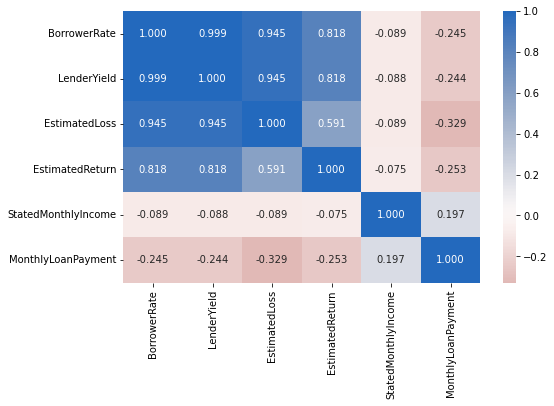

In [119]:
"""
In the heatmap the relationships among different variables are represented. Dark blue means there are strong correlation 
between two variables. I need this heatmap, because I want to figure out which columns I will use in the next parts.
"""

Col=['BorrowerRate','LenderYield','EstimatedLoss','EstimatedReturn','StatedMonthlyIncome','MonthlyLoanPayment']
plt.figure(figsize = [8, 5])
sb.heatmap(df[Col].corr(), annot = True, fmt = '.3f',
           cmap = 'vlag_r', center = 0)
plt.show()

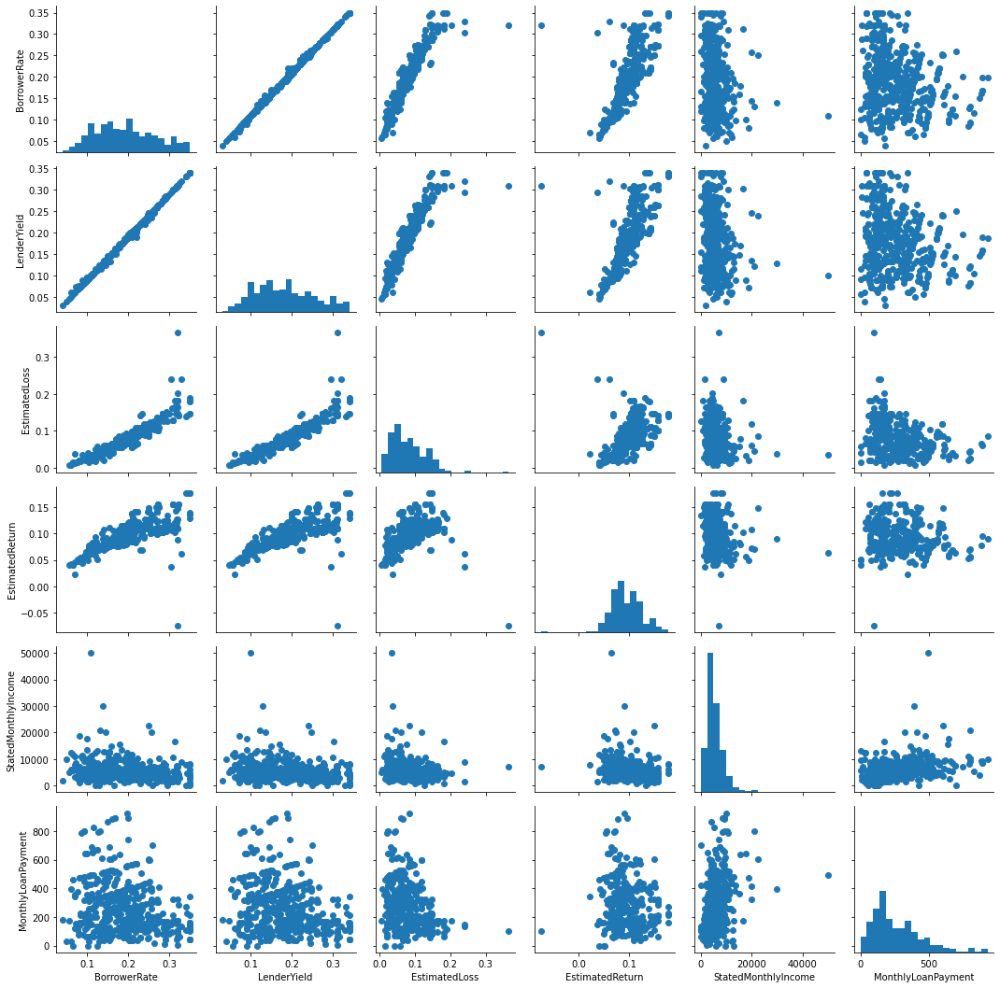

In [18]:
"""
Seeing several charts at once can lead to compare variables better. You can see scatter plots below.
"""

samples = np.random.choice(df.shape[0], 500, replace = False)
df_samp = df.loc[samples,:]

g = sb.PairGrid(data = df_samp, vars = vars)
g = g.map_diag(plt.hist, bins = 20);
g.map_offdiag(plt.scatter)

C:\Users\asifa\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

C:\Users\asifa\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



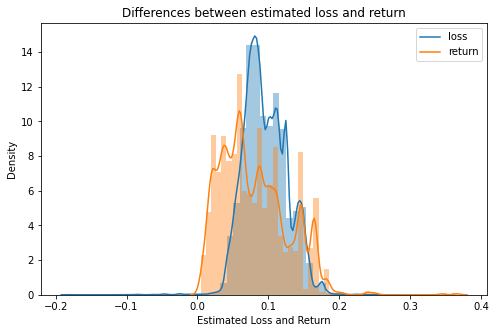

In [131]:
"""
Main goal for lender is to get high return as much as possioble. Let's look in general how estimated loss and estimated
return change. As you can see loss is higher than return. In the next parts I will compare these for specidic occupations.
"""
plt.figure(figsize=[8, 5])
sb.distplot(df['EstimatedReturn']).set(title='Differences between estimated loss and return')
sb.distplot(df['EstimatedLoss'])
plt.xlabel("Estimated Loss and Return")
plt.legend(["loss","return"])

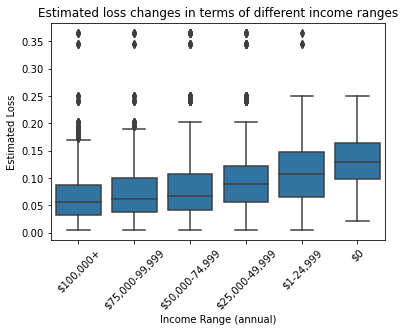

In [147]:
"""
In the boxplot we can see that estimated loss goes higer when income decreases.
"""
sb.boxplot(data=df, x='IncomeRange', y='EstimatedLoss',order=['$100,000+','$75,000-99,999', '$50,000-74,999','$25,000-49,999','$1-24,999','$0'],
          color=base_color)
plt.title("Estimated loss changes in terms of different income ranges")
plt.ylabel("Estimated Loss")
plt.xlabel("Income Range (annual)")
plt.xticks(rotation=45);

In [20]:
"""
The graph represents Late payment counts that more than one month. We see that back payment increases year by year.
"""


fig = px.line(data_frame=df, x=sorted(df['DateCreditPulled']), y='ProsperPaymentsOneMonthPlusLate', 
              title="Late Payments change by years",
             labels={"x": "Years",
                     "ProsperPaymentsOneMonthPlusLate": "One month plus late payments count"})


fig.show()


In [21]:
"""
Here I want to analyse minimum and maximum earning occupations in average and find out how does relationship change between monthly income and 
prosper payment on time. I found that most earned profession is Doctor and least earning people are Students from Sophomo College.
Scatter plots shows that there are positive correlation between these two variables.
"""




print(df.groupby("Occupation")["StatedMonthlyIncome"].mean().max())
print(df.groupby("Occupation")["StatedMonthlyIncome"].mean().min())

14936.942813753038
1005.2898550434783


In [22]:
frame=pd.DataFrame(df.groupby("Occupation")["StatedMonthlyIncome"].mean())
print(frame[frame['StatedMonthlyIncome']==1005.2898550434783])
print(frame[frame['StatedMonthlyIncome']==14936.942813753038])

                             StatedMonthlyIncome
Occupation                                      
Student - College Sophomore          1005.289855
            StatedMonthlyIncome
Occupation                     
Doctor             14936.942814


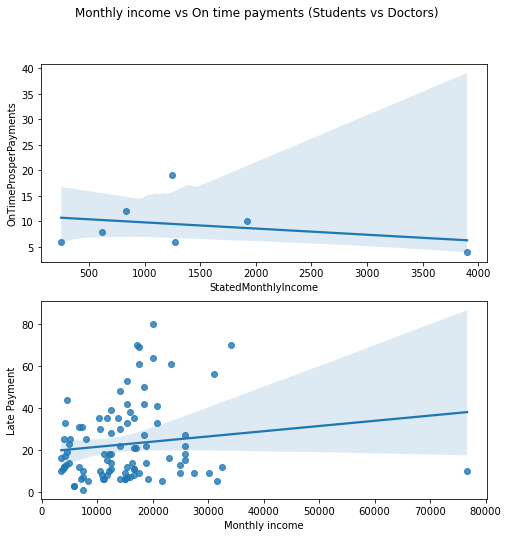

In [23]:
Comp=df[df['Occupation']=='Student - College Sophomore']
Doc=df[df['Occupation']=='Doctor']

fig, ax = plt.subplots(nrows=2, figsize = [8,8])
sb.regplot(data=Comp, x='StatedMonthlyIncome', y='OnTimeProsperPayments', ax=ax[0])
sb.regplot(data=Doc, x='StatedMonthlyIncome', y='OnTimeProsperPayments',ax=ax[1])
plt.xlabel("Monthly income")
plt.ylabel("Late Payment")
plt.suptitle("Monthly income vs On time payments (Students vs Doctors)")
plt.show()

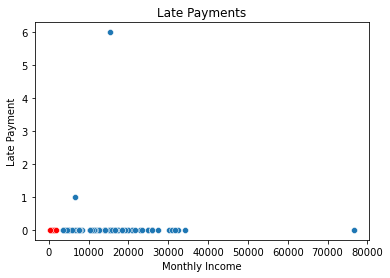

In [24]:
"""
Althrough Students are less earned people there are no late payment, but some doctors have late payments.
"""

sb.scatterplot(data=Comp, x='StatedMonthlyIncome', y='ProsperPaymentsOneMonthPlusLate', color='red')
sb.scatterplot(data=Doc, x='StatedMonthlyIncome', y='ProsperPaymentsOneMonthPlusLate')
plt.xlabel("Monthly Income")
plt.ylabel("Late Payment")
plt.title("Late Payments")
plt.show()

## Good performance versus Bad performance
From this part I will create 2 data sets which are called goodperformance and badperformance. In order to understand differences between occupations I want to seperate top 5 worst late payment performance occupation (badperformance) and top 5 highest income with perfect payment record occupations. 

In [149]:
"""
Here I found top 5 occupations that have the worst payment performance. In order to achieve this I used group by function
and some aggregation. Analysts are the people who has the worst payment record.
"""


df['ProsperPaymentsOneMonthPlusLate'].unique()

array([nan,  0.,  1.,  5.,  2.,  3.,  7., 16.,  4., 21.,  9.,  8., 10.,
        6., 11., 12., 19., 18.])

In [26]:
frame2=pd.DataFrame(df.groupby("Occupation")["ProsperPaymentsOneMonthPlusLate","StatedMonthlyIncome"].agg({'ProsperPaymentsOneMonthPlusLate':'sum','StatedMonthlyIncome':'mean'}))
frame2=frame2.sort_values(by='ProsperPaymentsOneMonthPlusLate',ascending=False)
frame2 = frame2.reset_index()
frame2.columns = ['Occupations', 'Late Payments', 'Monthly income']
frame2

C:\Users\asifa\AppData\Local\Temp/ipykernel_19760/3185797329.py:1: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



,Occupations,Late Payments,Monthly income
0,Other,281.0,4685.025623
1,Professional,238.0,7050.184516
2,Analyst,100.0,6353.427864
3,Teacher,61.0,4602.784384
4,Administrative Assistant,40.0,3696.913255
...,...,...,...
62,Pilot - Private/Commercial,0.0,8818.666248
63,Homemaker,0.0,4148.551389
64,Medical Technician,0.0,4276.427484
65,Landscaping,0.0,3971.735523


In [27]:
frame3=frame2[2:].head()

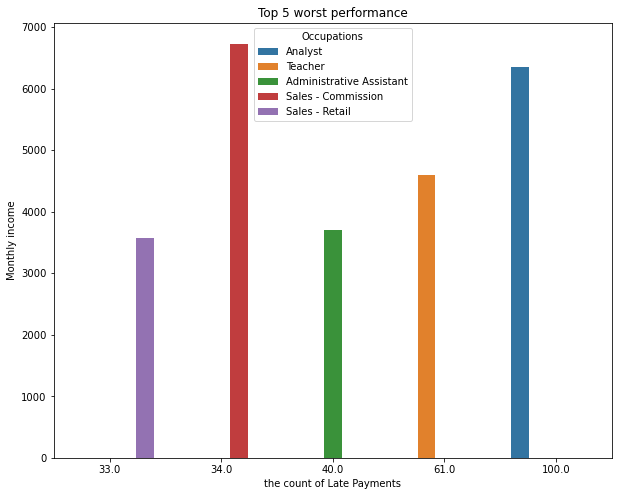

In [153]:
plt.figure(figsize=(10,8))
g = sb.barplot(data=frame3, x='Late Payments', y='Monthly income' , hue='Occupations' )
plt.ylabel("Monthly income")
plt.xlabel("the count of Late Payments")
plt.title("Top 5 worst performance");



In [29]:
badperformance=df.loc[df['Occupation'].isin(['Analyst', 'Teacher', 'Administrative Assistant','Sales - Commission','Sales - Retail'])]
badperformance['Occupation'].value_counts()

Teacher                     3759
Administrative Assistant    3688
Analyst                     3602
Sales - Commission          3446
Sales - Retail              2797
Name: Occupation, dtype: int64

In [166]:
frame4=frame2.sort_values('Monthly income', ascending=False)
a=frame4[frame4['Late Payments']==0.0].head()
a.head()

,Occupations,Late Payments,Monthly income
49,Attorney,0.0,11570.032027
54,Judge,0.0,10808.136364
66,Dentist,0.0,10548.066177
62,Pilot - Private/Commercial,0.0,8818.666248
57,Car Dealer,0.0,6313.756018


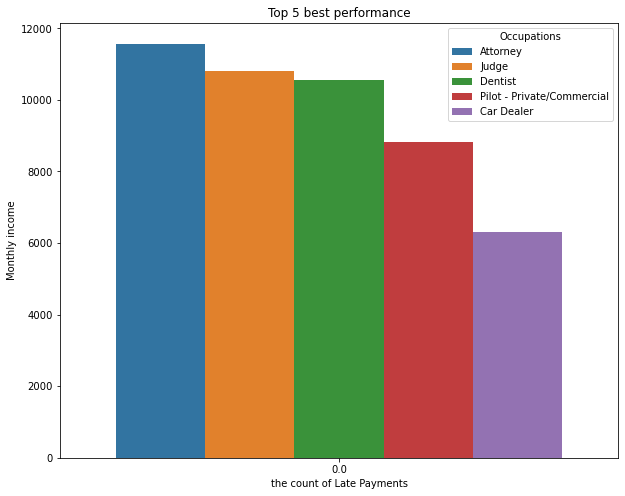

In [155]:
plt.figure(figsize=(10,8))
g = sb.barplot(data=a, x='Late Payments', y='Monthly income' , hue='Occupations' )
plt.ylabel("Monthly income")
plt.xlabel("the count of Late Payments")
plt.title("Top 5 best performance");

### What did I find in bivariante analysis?
So far I found out top 5 occupations that carry risk to pay money back in time. I also analysed credit ratings with income range. The analysis shows us most and least earned occupations and their relations with back payment.


### Did you observe any interesting relationships between the other features (not the main feature(s) of interest)?
One interesting thing was about Students. Students are less earned people but during the passed years there are no payment problem observed. However doctors earned a lot there are some problem in their payment record.


## Multivariante Exploration

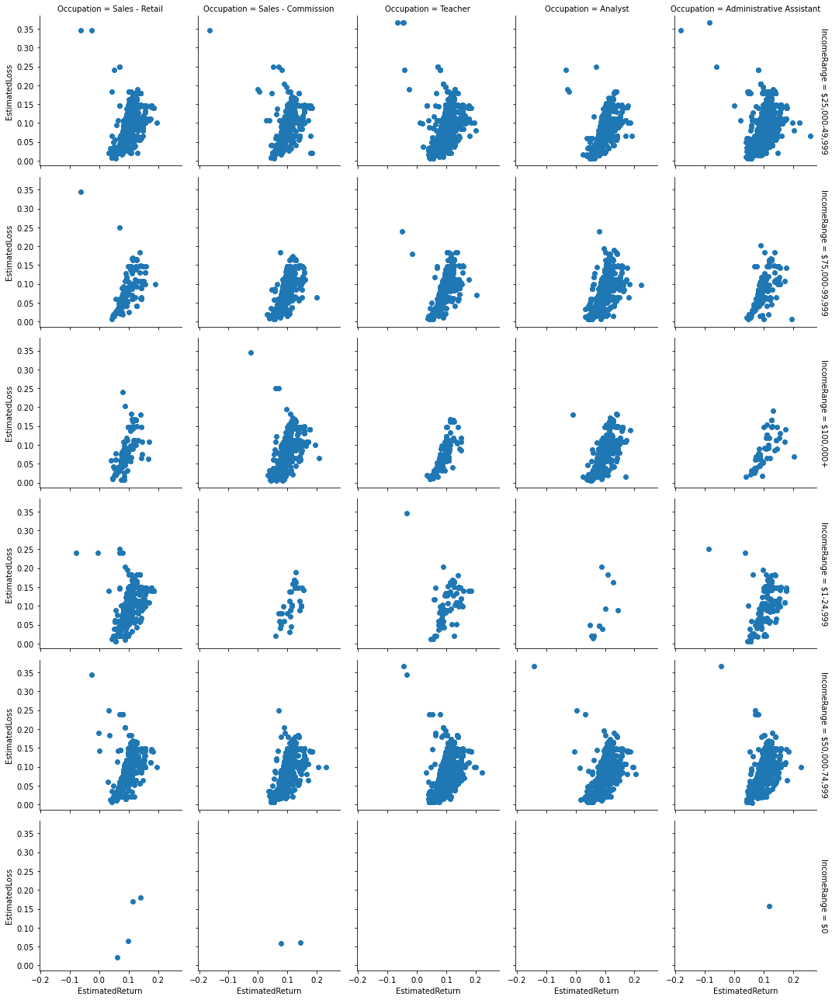

In [156]:
"""
In the multivariante part I want to look each occupations' estimated loss and return and income ranges. In first facet I 
will look badperformance dataset and in the second part I will try to find same values for goodperformance dataset in order to 
compare the values.
"""

badperformance=badperformance.loc[badperformance['IncomeRange'].isin(['$100,000+','$75,000-99,999', '$50,000-74,999','$25,000-49,999','$1-24,999','$0'])]
grid = sb.FacetGrid(badperformance, row="IncomeRange", col="Occupation", margin_titles=True, sharey=True)
grid.map(plt.scatter, "EstimatedReturn","EstimatedLoss")



In [71]:
goodperformance=df.loc[df['Occupation'].isin(['Attorney', 'Judge', 'Dentist','Pilot - Private/Commercial','Car Dealer'])]
goodperformance=goodperformance.loc[goodperformance['IncomeRange'].isin(['$100,000+','$75,000-99,999', '$50,000-74,999','$25,000-49,999','$1-24,999','$0'])]

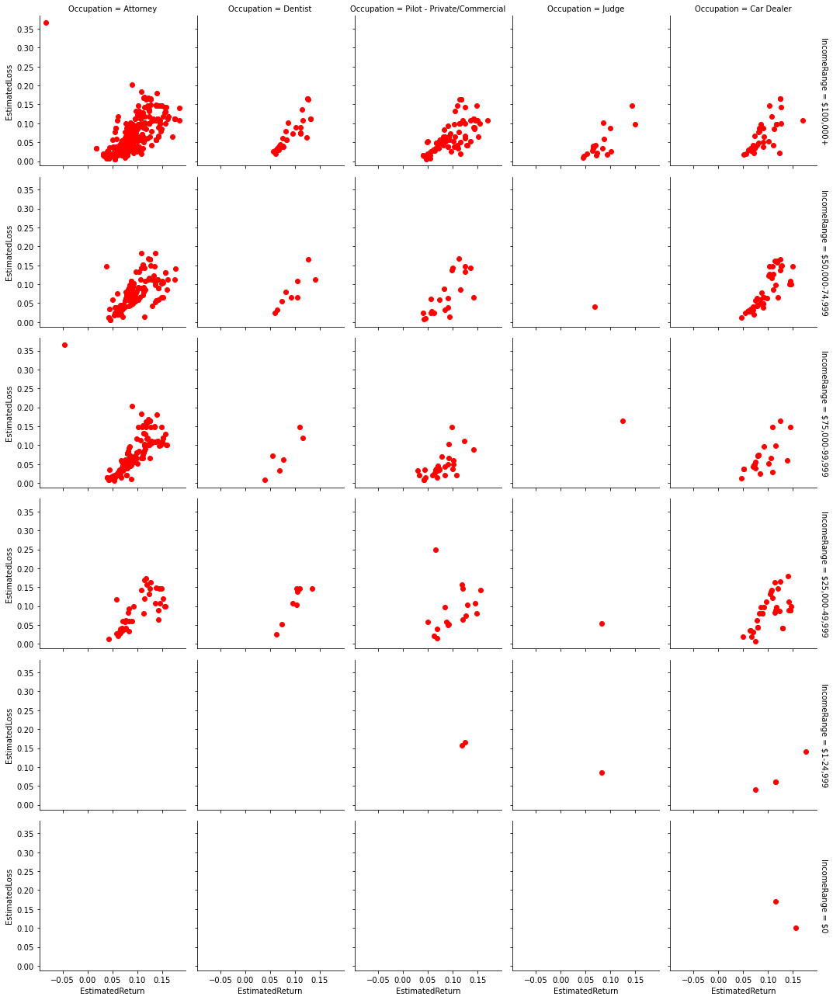

In [112]:
grid = sb.FacetGrid(goodperformance, row="IncomeRange", col="Occupation", margin_titles=True, sharey=True)
grid.map(plt.scatter, "EstimatedReturn","EstimatedLoss", color='red')

C:\Users\asifa\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y, data. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.

C:\Users\asifa\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y, data. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



Text(0.5, 1.08, 'Estimated return and loss in terms of bad performance')

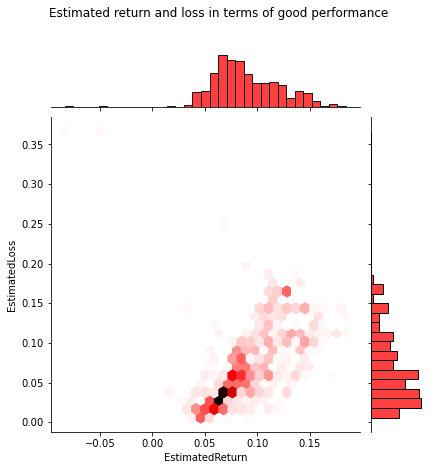

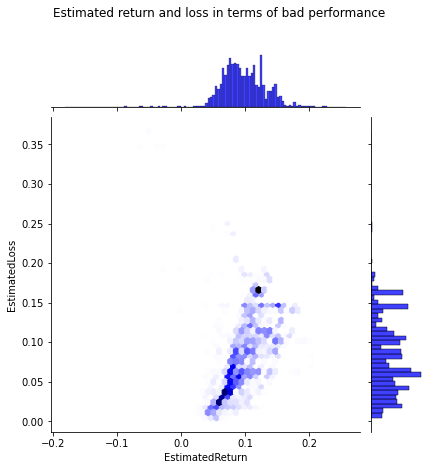

In [164]:
"""
Here you can see heatmap and histogram of estimated return and estimated loss at the same time. 
""" 
sb.jointplot("EstimatedReturn", "EstimatedLoss", goodperformance, kind='hex',color='red')
plt.suptitle("Estimated return and loss in terms of good performance",y=1.08)
sb.jointplot("EstimatedReturn", "EstimatedLoss", badperformance, kind='hex', color='blue')
plt.suptitle("Estimated return and loss in terms of bad performance", y=1.08)

## Talk about some of the relationships you observed in this part of the investigation. Were there features that strengthened each other in terms of looking at your feature(s) of interest
In this part I tried to analysed multi variante visualizations. My main point was compare good and bad performanced occupations estimated loss and returns. Returns are the most important factor for lender. This is why I think who has most return lenders are trying to give them money. It shows that really good performanced occupations will bring high return. This means there are lower risk to lend them.

## Were there any interesting or surprising interactions between features?
Interesting part for me was to look income range of occupations which had low income but they have no late payments. These occupations were mainly students. 

## Conclusions
As conclusion, I want sum all of findings up. I took into accounts several factors in order to find most reliable slice of population to lend money. I found that from high income prespective good performances occupations are suitable people to lend money, although there are some late payments recorded, they still have good background. 
When I analysed payment records I found out that analysts have the worst performance. Here I do not advice to lend money to them. 